<a href="https://colab.research.google.com/github/shahabday/Project.Sonata/blob/main/test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 484.9/484.9 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 14.2 MB/s eta 0:00:00


In [ ]:
import os
from datasets import load_dataset



In [11]:
import os

# Step 1: Create Directory for MIDI Files
os.makedirs("maestro_midi", exist_ok=True)

# Step 2: Download the dataset (ZIP format)
maestro_url = "https://storage.googleapis.com/magentadata/datasets/maestro/v3.0.0/maestro-v3.0.0-midi.zip"
zip_path = "maestro_midi.zip"

print("Downloading Maestro MIDI dataset...")
os.system(f"wget {maestro_url} -O {zip_path}")

# Step 3: Extract only MIDI files
print("Extracting MIDI files...")
os.system("unzip -j maestro_midi.zip '*.midi' -d maestro_midi")

# Step 4: Clean up (Optional)
os.remove(zip_path)

print("Download and extraction complete! MIDI files are in 'maestro_midi' directory.")



Extracting MIDI files...
Download and extraction complete! MIDI files are in 'maestro_midi' directory.


In [2]:
import os
import pandas as pd

# Step 1: Create Directory for MIDI Files and Metadata
os.makedirs("maestro_dataset", exist_ok=True)

# Step 2: Download Metadata CSV
metadata_url = "https://storage.googleapis.com/magentadata/datasets/maestro/v3.0.0/maestro-v3.0.0.csv"
metadata_path = "maestro_dataset/maestro_metadata.csv"

print("Downloading Maestro metadata...")
os.system(f"wget {metadata_url} -O {metadata_path}")

# Step 3: Load Metadata
metadata_df = pd.read_csv(metadata_path)

# Step 4: Show Metadata Columns
print(metadata_df.head())

# Example: Find all Beethoven sonatas
beethoven_sonatas = metadata_df[metadata_df["canonical_composer"].str.contains("Beethoven", na=False)]
print(beethoven_sonatas)


   canonical_composer                canonical_title       split  year  \
0          Alban Berg                   Sonata Op. 1       train  2018   
1          Alban Berg                   Sonata Op. 1       train  2008   
2          Alban Berg                   Sonata Op. 1       train  2017   
3  Alexander Scriabin  24 Preludes Op. 11, No. 13-24       train  2004   
4  Alexander Scriabin               3 Etudes, Op. 65  validation  2006   

                                       midi_filename  \
0  2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...   
1  2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...   
2  2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...   
3  2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...   
4  2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...   

                                      audio_filename    duration  
0  2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...  698.661160  
1  2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...  759.518471  
2  2017/MIDI-Unpr

In [4]:
metadata_df

,canonical_composer,canonical_title,split,year,midi_filename,audio_filename,duration
0,Alban Berg,Sonata Op. 1,train,2018,2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...,2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...,698.661160
1,Alban Berg,Sonata Op. 1,train,2008,2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...,2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...,759.518471
2,Alban Berg,Sonata Op. 1,train,2017,2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...,2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...,464.649433
3,Alexander Scriabin,"24 Preludes Op. 11, No. 13-24",train,2004,2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...,2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...,872.640588
4,Alexander Scriabin,"3 Etudes, Op. 65",validation,2006,2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...,2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...,397.857508
...,...,...,...,...,...,...,...
1271,Wolfgang Amadeus Mozart,"Sonata in F Major, K280",test,2004,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,241.470442
1272,Wolfgang Amadeus Mozart,"Sonata in F Major, K280",train,2004,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,114.696243
1273,Wolfgang Amadeus Mozart,"Sonata in F Major, K533",validation,2004,2004/MIDI-Unprocessed_SMF_12_01_2004_01-05_ORI...,2004/MIDI-Unprocessed_SMF_12_01_2004_01-05_ORI...,1139.198478
1274,Wolfgang Amadeus Mozart,"Sonata in F Major, K533/K494",validation,2018,2018/MIDI-Unprocessed_Recital17-19_MID--AUDIO_...,2018/MIDI-Unprocessed_Recital17-19_MID--AUDIO_...,1068.751602


In [6]:
import os
import pandas as pd
import IPython.display as ipd

In [8]:
!pip install pretty_midi


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 54.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 4.4 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.10-py3-none-any.whl size=5592287 sha256=986e09fcc91151f77c534e1a6fda85d804ce7d52b531de63d030646785281288
  Stored in directory: /root/.cache/pip/wheels/e6/95/ac/15ceaeb2823b04d8e638fd1495357adb8d26c00ccac9d7782e
Successfully built pretty_midi


In [12]:
import pretty_midi
import IPython.display as ipd

# Function to convert and play MIDI as audio
def play_midi(midi_path):
    midi_data = pretty_midi.PrettyMIDI(midi_path)
    audio_data = midi_data.synthesize(fs=44100)  # Convert to audio waveform
    return ipd.Audio(audio_data, rate=44100)

# Example: Play the first Beethoven Sonata
if not beethoven_sonatas.empty:
    midi_path = "maestro_dataset/" + beethoven_sonatas.iloc[0]["midi_filename"]
    play_midi(midi_path)
else:
    print("No Beethoven sonatas found.")


FileNotFoundError: [Errno 2] No such file or directory: 'maestro_dataset/2004/MIDI-Unprocessed_SMF_13_01_2004_01-05_ORIG_MID--AUDIO_13_R1_2004_05_Track05_wav.midi'

In [13]:
play_midi('/content/maestro_midi/MIDI-Unprocessed_R1_D2-13-20_mid--AUDIO-from_mp3_17_R1_2015_wav--1.midi')

In [9]:
!apt-get install fluidsynth
!pip install midi2audio

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libevdev2 libfluidsynth3 libgudev-1.0-0 libinput-bin libinput10
  libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a libqt5dbus5 libqt5gui5 libqt5network5
  libqt5svg5 libqt5widgets5 libwacom-bin libwacom-common libwacom9 libxcb-icccm4 libxcb-image0
  libxcb-keysyms1 libxcb-render-util0 libxcb-util1 libxcb-xinerama0 libxcb-xinput0 libxcb-xkb1
  libxkbcommon-x11-0 qsynth qt5-gtk-platformtheme qttranslations5-l10n timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs qt5-image-formats-plugins qtwayland5 jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libevdev2 libfluidsynth3 libgudev-1.0-0 libinput-bin libinput10
  libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a libqt5dbus5 libqt5gui5 libqt5network5
  libqt5svg5 libqt5widgets5 libwacom-bin libwacom-common libwacom9 libxcb-icc

In [ ]:
from midi2audio import FluidSynth

# Set up FluidSynth
fs = FluidSynth()
midi_path = "maestro_dataset/" + beethoven_sonatas.iloc[0]["midi_filename"]
wav_path = midi_path.replace(".midi", ".wav")

# Convert MIDI to WAV
fs.midi_to_audio(midi_path, wav_path)

# Play the converted audio
ipd.Audio(wav_path)


## Visualizing MIDI

In [15]:
!pip install pretty_midi matplotlib


In [17]:
midi_path = '/content/maestro_midi/MIDI-Unprocessed_R1_D2-13-20_mid--AUDIO-from_mp3_18_R1_2015_wav--1.midi'

In [16]:
import pretty_midi
import matplotlib.pyplot as plt
import numpy as np

# Function to plot a MIDI piano roll
def plot_piano_roll(midi_path):
    midi_data = pretty_midi.PrettyMIDI(midi_path)

    # Create a piano roll
    piano_roll = midi_data.get_piano_roll(fs=10)  # fs=10 gives 10 time steps per second

    # Plot the piano roll
    plt.figure(figsize=(12, 6))
    plt.imshow(piano_roll[::-1], aspect='auto', cmap='hot', interpolation='nearest')
    plt.xlabel("Time (frames)")
    plt.ylabel("MIDI Note Number")
    plt.title("Piano Roll Visualization")
    plt.colorbar(label="Velocity")
    plt.show()


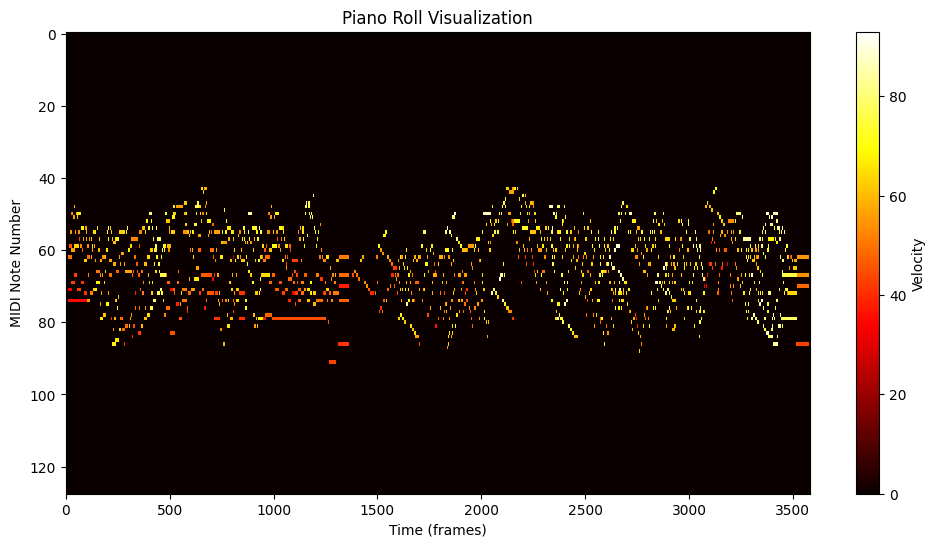

In [18]:
plot_piano_roll(midi_path)

In [ ]:
def plot_midi_notes(midi_path):
    midi_data = pretty_midi.PrettyMIDI(midi_path)

    plt.figure(figsize=(12, 6))

    for instrument in midi_data.instruments:
        for note in instrument.notes:
            plt.plot([note.start, note.end], [note.pitch, note.pitch], linewidth=2)

    plt.xlabel("Time (seconds)")
    plt.ylabel("MIDI Note Number")
    plt.title("MIDI Notes Over Time")
    plt.grid(True)
    plt.show()


plot_midi_notes(midi_path)
